# **Assignment 1 – Simple Linear Regression**
**Goal:** Understand the basics of regression by creating your own dataset.

### Steps:
1. Formulate your own equation in the form:  
   $
   y = m x + c
   $
   
   Example: $y = 2x + 3$
2. Generate X values (at least 100 numbers between your chosen range).
3. Generate Y values using your equation.
4. Add small random noise to Y to make it realistic.
5. Split data into train and test splits
6. Fit a Simple Linear Regression model.
7. Print learned coefficient and intercept.
8. Split the data into train and test sets (80%-20%).
9. Evaluate both train and test using MAE, MSE, R² score.
> Write your notes about model performance and whether the model suffers from overfitting or underfitting.
10. Visualize the points and the fitted line.


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set()

my equation -> y = 3x+2

In [20]:
# generating x values
x = np.random.randint(500 , size=200)
x

array([207,  67, 154, 343, 382, 210, 462,  64,  43, 198, 372, 369, 151,
        98, 291, 123, 344, 155, 123,  54, 434, 100, 479,  68, 220,  95,
       375, 227, 391,   4, 302, 340, 436, 231,  74, 132, 261, 249, 338,
       479, 349, 147, 374, 343,  49, 388, 432, 402, 186, 333, 207, 187,
       232, 315,  22,  26, 458, 236, 415, 305, 414,   1, 164, 228, 158,
       295, 467, 317, 387, 147, 289, 486, 406,  82,  83, 279,  56, 442,
        40, 169, 165, 151, 137, 173, 127, 391, 419, 294, 324,  44, 302,
       357, 378, 319, 125, 481,  89, 104, 229, 223, 470, 450, 457, 233,
       180, 418,  18, 497, 376, 131, 186, 185, 168,   0, 402, 310, 470,
       109, 199, 120, 198, 248, 289, 381,  14, 139, 187, 366, 391, 281,
       412, 475, 261, 421, 302, 425, 212, 217, 483, 138, 273, 122, 422,
       397, 406, 337,  54, 101, 129, 282, 289, 281, 222, 491, 481,  29,
       217, 447, 420, 245, 251, 340, 344, 462,   9, 379, 204, 152, 377,
        59,  63,  37, 144,   2, 488, 385, 134, 246, 304, 151,  5

In [25]:
# generating y values from x
y = np.array([3*num + 2 for num in x])
y

array([ 623,  203,  464, 1031, 1148,  632, 1388,  194,  131,  596, 1118,
       1109,  455,  296,  875,  371, 1034,  467,  371,  164, 1304,  302,
       1439,  206,  662,  287, 1127,  683, 1175,   14,  908, 1022, 1310,
        695,  224,  398,  785,  749, 1016, 1439, 1049,  443, 1124, 1031,
        149, 1166, 1298, 1208,  560, 1001,  623,  563,  698,  947,   68,
         80, 1376,  710, 1247,  917, 1244,    5,  494,  686,  476,  887,
       1403,  953, 1163,  443,  869, 1460, 1220,  248,  251,  839,  170,
       1328,  122,  509,  497,  455,  413,  521,  383, 1175, 1259,  884,
        974,  134,  908, 1073, 1136,  959,  377, 1445,  269,  314,  689,
        671, 1412, 1352, 1373,  701,  542, 1256,   56, 1493, 1130,  395,
        560,  557,  506,    2, 1208,  932, 1412,  329,  599,  362,  596,
        746,  869, 1145,   44,  419,  563, 1100, 1175,  845, 1238, 1427,
        785, 1265,  908, 1277,  638,  653, 1451,  416,  821,  368, 1268,
       1193, 1220, 1013,  164,  305,  389,  848,  8

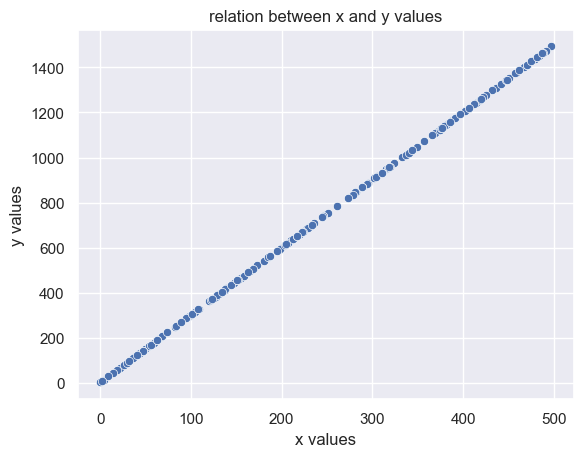

In [22]:
#visualizing the relation between x and y values
sns.scatterplot(x = x , y = y)
plt.title('relation between x and y values')
plt.xlabel('x values')
plt.ylabel('y values')
plt.show()

so the relation is perfectly linear 

In [ ]:
# adding some noise to y
# Standard deviation of noise
noise_std = 2  

# Add Gaussian noise
noise = np.random.randn(200) * noise_std
y = y.astype('float64')
y += noise
y

array([ 623.44456343,  200.49346379,  463.71940292, 1033.13433157,
       1148.68420053,  632.94885423, 1389.80044906,  193.18378134,
        132.63303853,  594.61213574, 1116.54879858, 1108.15013865,
        456.94504278,  298.36437513,  874.49382787,  371.94134312,
       1035.8350862 ,  466.1708625 ,  372.37407944,  163.34581687,
       1302.0170329 ,  307.26735413, 1438.08828094,  202.01551329,
        659.99154766,  286.41362352, 1130.0115569 ,  684.16530086,
       1173.55231038,   10.08878857,  903.54601899, 1024.73407827,
       1305.82402176,  695.77089585,  221.61693682,  394.47055733,
        784.10574927,  748.2515137 , 1015.53283756, 1437.92560914,
       1049.44959997,  443.35116285, 1126.25586597, 1031.48575142,
        147.70486059, 1164.96994533, 1295.46097353, 1211.97884971,
        562.67215982, 1001.96071648,  622.47172551,  560.38208931,
        693.55522111,  946.38627099,   69.51811308,   81.77334473,
       1376.25624663,  710.2519958 , 1245.67289598,  912.27092

In [ ]:
# spliting the data
from sklearn.model_selection import train_test_split
x_train , x_test , y_train , y_test = train_test_split(x , y , random_state=42 , test_size=0.2)

In [18]:
# import linear regression from sklearn and make object from it
from sklearn.linear_model import LinearRegression
LR = LinearRegression()

In [ ]:
# train the model on the data
LR.fit(x_train.reshape(-1 ,1) , y_train)

LinearRegression()

In [ ]:
# make prediction on the test data
y_pred = LR.predict(x_test.reshape(-1,1))
y_pred

array([1445.0703673 ,  370.77533268,  907.92284999, 1262.02009604,
       1174.99619658,  931.92944294,  442.79511154,  190.72588554,
       1466.07613613, 1165.99372423, 1403.05882963,  325.7629709 ,
       1138.98630716,  121.7069308 ,  931.92944294,  739.87669932,
       1376.05141256,  667.85692047,  412.78687035, 1162.99290011,
         43.68550371, 1033.95746299,  388.7802774 ,  958.93686001,
        886.91708116, 1244.01515132,  382.77862916,  952.93521177,
        418.78851859,  784.88906111,  595.83714161,  370.77533268,
         79.69539313,  838.90389525,  868.91213644,  541.82230747,
       1277.02421663,  652.85279987,   28.68138311,  169.72011671])

In [42]:
# printing the coefficient of the data coefficient and intercept
print(f'the value of the coefficient of the data = {LR.coef_[0]}')

the value of the coefficient of the data = 3.000824119040219


In [44]:
# print the intercept of the data
print(f"the value of the intercept of the data = {LR.intercept_}")

the value of the intercept of the data = 1.6739660389447408


# testing for underfitting

In [49]:
# evaluate the values of MAE , MSE and r2 score for the train data
from sklearn.metrics import mean_absolute_error , mean_squared_error , r2_score
y_train_pred = LR.predict(x_train.reshape(-1,1))
print(f'the value of MAE is -> {mean_absolute_error(y_train , y_train_pred)}')
print(f'the value of MSE is -> {mean_squared_error(y_train , y_train_pred)}')
print(f'the value of R2 score is -> {r2_score(y_train , y_train_pred)}')

the value of MAE is -> 1.7892475771830554
the value of MSE is -> 4.820084293983269
the value of R2 score is -> 0.9999734067537074


- the error rate is  low compared with the data values range and r2 score is so good 
- the model doesn’t suffer from an underfitting

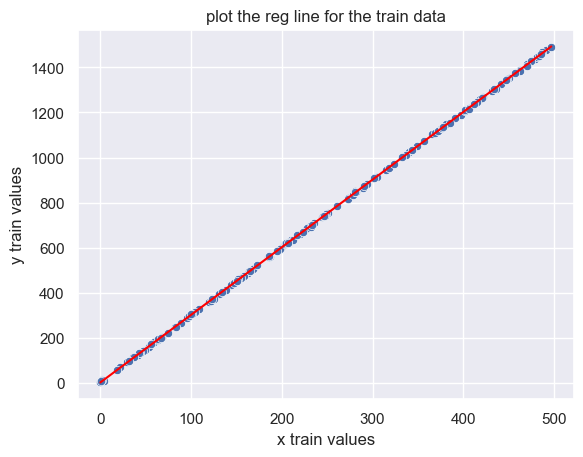

In [65]:
# plotting the data points and the regression line
sns.scatterplot(x = x_train , y = y_train )
sns.lineplot(x = x_train , y = y_train_pred , c='red')
plt.title('plot the reg line for the train data')
plt.xlabel('x train values')
plt.ylabel('y train values')
plt.show()

# testing for overfitting

In [47]:
# evaluating the values od MSE , MAE and r2 score for the predicted data
print(f'the value of MAE is -> {mean_absolute_error(y_test , y_pred)}')
print(f'the value of MSE is -> {mean_squared_error(y_test , y_pred)}')
print(f'the value of R2 score is -> {r2_score(y_test , y_pred)}')

the value of MAE is -> 1.6777802980158412
the value of MSE is -> 4.203962545107923
the value of R2 score is -> 0.9999766754400601


- the error rate is so low compared with the data values and r2 score is so good 
- the model doesn’t suffer from an overfitting

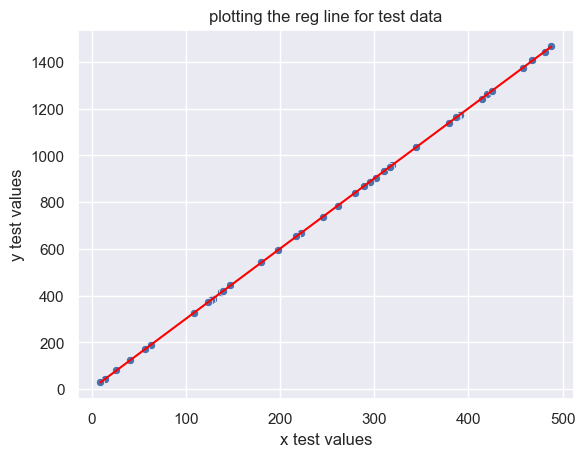

In [66]:
# plotting the data points and the regression line
sns.scatterplot(x = x_test , y = y_test)
sns.lineplot(x = x_test , y = y_pred , c='red')
plt.title('plotting the reg line for test data')
plt.xlabel('x test values')
plt.ylabel('y test values')
plt.show()

# **Assignment 2 – Multiple Linear Regression**
**Goal:** See how multiple features affect predictions.

### Steps:
1. Formulate your own equation:
   $
   y = a_1 x_1 + a_2 x_2 + c
   $
2. Generate `x1` and `x2` values (at least 100 numbers each).
3. Generate Y values with noise.
4. Split data into train and test splits
5. Fit a Multiple Linear Regression model.
6. Compare coefficients and intercept to your original equation.
7. Evaluate both train and test using MAE, MSE, R² score.
> Write your notes about model performance and whether the model suffers from overfitting or underfitting.



my equation -> y = 2x1 + 4x2 +1 

In [71]:
# init x1 data points
x1 = np.random.randint(200 , size = 100 ).astype('float64')
x1

array([ 26.,  24., 162., 131., 171.,  73., 104.,  40., 123., 191., 120.,
        83., 142., 105., 183., 164., 109., 170., 118., 134.,   3.,  31.,
       194., 117.,  96., 189., 156., 120., 190., 170., 108., 112., 141.,
        16.,  63., 103.,  86.,  55., 186.,  91.,  38., 165.,  65., 185.,
       191., 117.,  18., 122.,   5., 170., 151.,  45.,  39.,  78.,  73.,
       141.,  26., 199., 105.,  99.,  77., 184., 156.,  15., 169.,  45.,
       189., 196.,  78.,  14.,  74., 179., 122.,  53., 148.,  83., 176.,
        95.,  15., 109.,  19., 140.,  21., 137., 120.,   4., 144., 112.,
        44., 126., 111., 100., 184.,  97.,  91.,  80.,  53., 193.,  90.,
        54.])

In [72]:
# init x2 data points
x2 = np.random.randint(300 , size = 100).astype('float64')
x2

array([ 60.,  94., 231., 182., 169.,  56.,  56., 135., 139., 241.,  96.,
       169., 174.,  95.,  44., 254., 148., 294.,  30.,  37.,   2.,  13.,
        36., 210., 291.,  91., 266.,  62., 256., 182., 281., 216., 209.,
        99., 276., 141.,   5.,  76.,  61., 152., 218., 251.,  84., 104.,
        94.,  88., 232., 181.,  76., 140.,  75., 251.,   8., 145.,  81.,
        61., 158.,  26., 124., 249., 200., 214., 213., 135., 158., 283.,
       181.,  54., 291., 293.,   4., 187., 142., 295., 294.,  73., 154.,
        46.,  54., 183., 226., 285.,  92.,  82.,   0., 236.,  48.,  28.,
       175., 247., 159., 166.,  49.,  21.,  53.,  10., 111., 231., 102.,
       197.])

In [97]:
# init y values with noise
# Standard deviation of noise
noise_std = 3

# Add Gaussian noise
noise = np.random.randn(100) * noise_std
# for making things faster i made it in one line using list comprehension
y = np.array( [ (((2* num1) +( 4 * num2) +1) + noise1 ) for num1 ,num2 , noise1 in zip(x1 , x2 , noise) ] )
y

array([ 289.32018889,  422.39381671, 1251.95426427,  989.92167859,
       1015.62630627,  375.40897621,  429.73556941,  619.98717975,
        801.44317616, 1348.23316488,  631.66329925,  842.64438779,
        985.28544074,  589.59518905,  541.71007913, 1347.26153977,
        805.17947711, 1520.61073757,  358.42420606,  415.93448986,
         16.04654572,  112.3295096 ,  529.67468096, 1075.05100357,
       1357.22078718,  742.88546631, 1378.53548219,  487.44840315,
       1404.31654828, 1071.40642025, 1339.09777756, 1089.17313003,
       1116.47789239,  432.57503663, 1225.4112993 ,  771.71832249,
        191.53596054,  418.33197506,  618.58407338,  790.23581768,
        950.83075668, 1336.35602004,  467.5434747 ,  790.6102431 ,
        754.37934648,  587.23749536,  966.09090529,  971.62216891,
        313.45461392,  898.02227682,  599.95265664, 1103.42073375,
        106.12457674,  741.04070677,  466.45051322,  531.95589291,
        691.21373864,  500.21464168,  709.67447762, 1194.64656

In [98]:
x = np.array([np.array([num1 , num2]) for num1 , num2 in zip(x1,x2)])
x

array([[ 26.,  60.],
       [ 24.,  94.],
       [162., 231.],
       [131., 182.],
       [171., 169.],
       [ 73.,  56.],
       [104.,  56.],
       [ 40., 135.],
       [123., 139.],
       [191., 241.],
       [120.,  96.],
       [ 83., 169.],
       [142., 174.],
       [105.,  95.],
       [183.,  44.],
       [164., 254.],
       [109., 148.],
       [170., 294.],
       [118.,  30.],
       [134.,  37.],
       [  3.,   2.],
       [ 31.,  13.],
       [194.,  36.],
       [117., 210.],
       [ 96., 291.],
       [189.,  91.],
       [156., 266.],
       [120.,  62.],
       [190., 256.],
       [170., 182.],
       [108., 281.],
       [112., 216.],
       [141., 209.],
       [ 16.,  99.],
       [ 63., 276.],
       [103., 141.],
       [ 86.,   5.],
       [ 55.,  76.],
       [186.,  61.],
       [ 91., 152.],
       [ 38., 218.],
       [165., 251.],
       [ 65.,  84.],
       [185., 104.],
       [191.,  94.],
       [117.,  88.],
       [ 18., 232.],
       [122.,

splitting the data

In [99]:
x_train , x_test , y_train , y_test = train_test_split(x, y , random_state=42 , test_size=0.2)

In [100]:
LR.fit(x_train , y_train)

LinearRegression()

In [105]:
y_pred = LR.predict(x_test)

In [102]:
y_train_pred = LR.predict(x_train)

In [108]:
# printing the coefficient of the data coefficient and intercept
print(f'the value of the coefficient of the data = {LR.coef_}')

the value of the coefficient of the data = [2.00008601 4.00383882]


the values of the coefficient is almost the same

In [109]:
# print the intercept of the data
print(f"the value of the intercept of the data = {LR.intercept_}")

the value of the intercept of the data = 0.1897603586249943


the value of the intercept is so far from the real value

# testing for underfitting

In [ ]:
# evaluate the values of MAE , MSE and r2 score for the train data
print(f'the value of MAE is -> {mean_absolute_error(y_train , y_train_pred)}')
print(f'the value of MSE is -> {mean_squared_error(y_train , y_train_pred)}')
print(f'the value of R2 score is -> {r2_score(y_train , y_train_pred)}')

the value of MAE is -> 2.368075865358109
the value of MSE is -> 9.17756148926755
the value of R2 score is -> 0.999937965729507


there is no underfitting since the loss is low and r2 close to 1

# testing for overfitting

In [112]:
# evaluating the values od MSE , MAE and r2 score for the predicted data
print(f'the value of MAE is -> {mean_absolute_error(y_test , y_pred)}')
print(f'the value of MSE is -> {mean_squared_error(y_test , y_pred)}')
print(f'the value of R2 score is -> {r2_score(y_test , y_pred)}')

the value of MAE is -> 2.9980418386691357
the value of MSE is -> 12.302076576054828
the value of R2 score is -> 0.9998784552332136


there is no overfitting since the loss is low and r2 close to 1 (but the accuracy is lilbit lower than the train)

# **Assignment 3 – Polynomial Regression**
**Goal:** Model non-linear relationships.

### Steps:
1. Formulate your own equation:
   $
   y = ax^2 + bx + c
   $
2. Generate X values and Y values with noise.
3. Use `PolynomialFeatures` to transform X.
4. Split the data into train and test sets (80%-20%).
5. Fit a Linear Regression model on transformed features.
6. Evaluate both train and test using MAE, MSE, R² score.
> Write your notes about model performance and whether the model suffers from overfitting or underfitting.



my equation -> y = 3x**2 + 2x + 5

In [ ]:
# creating x points
x = np.arange(0,100,1)
x

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

In [ ]:
# creating y data points and adding noise
noise = np.random.randint(20 , size = 100)
y = np.array([(((3*(num**2)) + (2 * num)) + 5)+ nos for num , nos in zip(x , noise)])
y

array([    6,    27,    21,    49,    73,    95,   141,   172,   213,
         270,   342,   404,   478,   539,   633,   715,   805,   915,
        1025,  1142,  1250,  1371,  1513,  1653,  1793,  1940,  2086,
        2256,  2423,  2604,  2780,  2952,  3154,  3346,  3545,  3758,
        3967,  4192,  4422,  4661,  4886,  5136,  5400,  5648,  5901,
        6188,  6463,  6730,  7013,  7316,  7620,  7926,  8230,  8541,
        8869,  9203,  9542,  9866, 10226, 10582, 10936, 11297, 11678,
       12041, 12432, 12816, 13216, 13613, 14020, 14436, 14863, 15278,
       15720, 16143, 16587, 17041, 17492, 17948, 18416, 18893, 19368,
       19865, 20358, 20843, 21350, 21856, 22381, 22893, 23422, 23961,
       24490, 25046, 25592, 26157, 26701, 27287, 27854, 28429, 29025,
       29611])

In [ ]:
# transform the data to higher dim
from sklearn.preprocessing import PolynomialFeatures
poly = PolynomialFeatures(degree=4)
x_poly = poly.fit_transform(x.reshape(-1,1))
x_poly

array([[1.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
        0.0000000e+00],
       [1.0000000e+00, 1.0000000e+00, 1.0000000e+00, 1.0000000e+00,
        1.0000000e+00],
       [1.0000000e+00, 2.0000000e+00, 4.0000000e+00, 8.0000000e+00,
        1.6000000e+01],
       [1.0000000e+00, 3.0000000e+00, 9.0000000e+00, 2.7000000e+01,
        8.1000000e+01],
       [1.0000000e+00, 4.0000000e+00, 1.6000000e+01, 6.4000000e+01,
        2.5600000e+02],
       [1.0000000e+00, 5.0000000e+00, 2.5000000e+01, 1.2500000e+02,
        6.2500000e+02],
       [1.0000000e+00, 6.0000000e+00, 3.6000000e+01, 2.1600000e+02,
        1.2960000e+03],
       [1.0000000e+00, 7.0000000e+00, 4.9000000e+01, 3.4300000e+02,
        2.4010000e+03],
       [1.0000000e+00, 8.0000000e+00, 6.4000000e+01, 5.1200000e+02,
        4.0960000e+03],
       [1.0000000e+00, 9.0000000e+00, 8.1000000e+01, 7.2900000e+02,
        6.5610000e+03],
       [1.0000000e+00, 1.0000000e+01, 1.0000000e+02, 1.0000000e+03,
        1.00

In [ ]:
# spiltting the data
from sklearn.model_selection import train_test_split
x_train , x_test , y_train ,y_test = train_test_split(x_poly,y,random_state=42 , test_size=0.2)

In [ ]:
# fitting LR on train data
LR.fit(x_train , y_train)

LinearRegression()

In [23]:
# make prediction on train and test data
y_train_pred = LR.predict(x_train)
y_pred = LR.predict(x_test)

# test for underfitting

In [24]:
# evaluate the values of MAE , MSE and r2 score for the train data
from sklearn.metrics import mean_absolute_error , mean_squared_error , r2_score

print(f'the value of MAE is -> {mean_absolute_error(y_train , y_train_pred)}')
print(f'the value of MSE is -> {mean_squared_error(y_train , y_train_pred)}')
print(f'the value of R2 score is -> {r2_score(y_train , y_train_pred)}')

the value of MAE is -> 4.631086485576155
the value of MSE is -> 29.59208777006745
the value of R2 score is -> 0.9999996413809409


i think the model done good on the train data and it doesn’t suffer from underfitting

# test for overfitting

In [25]:
# evaluating the values od MSE , MAE and r2 score for the predicted data
print(f'the value of MAE is -> {mean_absolute_error(y_test , y_pred)}')
print(f'the value of MSE is -> {mean_squared_error(y_test , y_pred)}')
print(f'the value of R2 score is -> {r2_score(y_test , y_pred)}')

the value of MAE is -> 6.309980804117162
the value of MSE is -> 44.767125872591514
the value of R2 score is -> 0.9999993063533623


the model here also done good but the error rate is higher which means it didn’t learn that much but it still good and close to the train

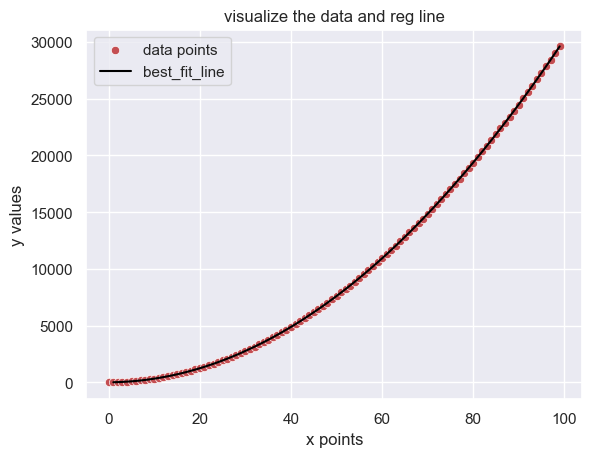

In [34]:
# viz the general line
sns.scatterplot(x = x , y = y , label = 'data points' , c = 'r')
sns.lineplot(x=x_train[:,1] , y =y_train_pred , label = 'best_fit_line' ,c='black' )
plt.title('visualize the data and reg line')
plt.xlabel('x points')
plt.ylabel('y values')
plt.legend()
plt.show()

## Machine Learning Project Pipeline

### 1. **Exploratory Data Analysis (EDA)**
- Inspect dataset structure (`.info()`, `.describe()`)
- Check for missing values and duplicates
- Understand feature types (numeric, categorical, datetime, etc.)
- Visualize data distributions (histograms, boxplots, bar charts)
- Identify correlations between features and target
- Detect outliers and anomalies

---

### 2. **Data Cleaning**
- Handle missing values (drop, fill with mean/median/mode, or use predictive imputation)
- Remove duplicates
- Fix inconsistent data formats (e.g., date parsing, string trimming)
- Correct data entry errors or outliers (if verified)

---

### 3. **Data Pre-processing**
- Convert data types if necessary (e.g., `object` to `datetime` or numeric)
- Handle categorical variables:
  - **Encoding**:
    - One-Hot Encoding (for nominal categories)
    - Ordinal Encoding (for ordered categories)
- Verify numeric features:
  - Check for incorrect values (e.g., negative ages)
  - Apply transformations if needed (e.g., log transform for skewed data)

---

### 4. **Scaling Numeric Features**
- Standardization (`StandardScaler`) — mean = 0, std = 1
- Normalization (`MinMaxScaler`) — values between 0 and 1
- Robust Scaling (less sensitive to outliers)

---

### 5. **Splitting Data**
- **Train-Test Split**
  - Typically 70–80% for training, 20–30% for testing
  - Use `train_test_split` from `sklearn`
  - Set `random_state` for reproducibility
- Optional: create a **validation set** for model tuning

---

### 6. **Modeling**
- Choose model type based on task:
  - **Regression:** Linear Regression
- Train the model on training data (Your target is `price`)

---

### 7. **Evaluating the Model**
- **On Training Data**:
  - Evaluate for underfitting (low train performance)
- **On Testing Data**:
  - Evaluate for overfitting (high train, low test performance)
- Metrics:
  - **Regression:** MAE, MSE, RMSE, R²

---

### 8. **Final Steps**
- Save the model (`joblib` or `pickle`)



In [1]:
import kagglehub
import os
# Download latest version
path = kagglehub.dataset_download("rohitgrewal/airlines-flights-data")

print("Path to dataset files:", path)

Path to dataset files: C:\Users\DELL\.cache\kagglehub\datasets\rohitgrewal\airlines-flights-data\versions\1


In [2]:
os.listdir(path)

['airlines_flights_data.csv']

In [3]:
full_path = os.path.join(path,os.listdir(path)[0])

In [58]:
import pandas as pd
df = pd.read_csv(full_path)

In [59]:
df

,index,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955
...,...,...,...,...,...,...,...,...,...,...,...,...
300148,300148,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,69265
300149,300149,Vistara,UK-826,Chennai,Afternoon,one,Night,Hyderabad,Business,10.42,49,77105
300150,300150,Vistara,UK-832,Chennai,Early_Morning,one,Night,Hyderabad,Business,13.83,49,79099
300151,300151,Vistara,UK-828,Chennai,Early_Morning,one,Evening,Hyderabad,Business,10.00,49,81585


## OPTIONAL SUGGESTIONS for Visualizations for Flight Price Dataset
> **YOU MUST MAKE VISUALIZATIONS. THESE ARE ONLY SUGGESTIONS**
### 1. **Numeric Data Visualizations**
(Columns: `duration`, `days_left`, `price`)

**a. Distribution of Numeric Features**
- **Histograms / KDE plots**  
  - Price distribution — check for skewness.  
  - Duration distribution — detect common flight lengths.  
  - Days left — reveal booking patterns.

**b. Boxplots for Outlier Detection**
- Boxplot of `price` — spot extreme values.
- Boxplot of `duration` grouped by `class` or `airline`.

**c. Price vs Numeric Feature Relationships**
- Scatter plot: `price` vs `duration` (color by `class` or `airline`).
- Scatter plot: `price` vs `days_left` (color by `class` or `stops`).

---

### 2. **Categorical Data Visualizations**
(Columns: `airline`, `flight`, `source_city`, `departure_time`, `stops`, `arrival_time`, `destination_city`, `class`)

**a. Price Trends by Category**
- **Boxplots**
  - `price` by `airline` — compare average fares.
  - `price` by `source_city` or `destination_city`.
  - `price` by `stops` — direct vs connecting flights.

**b. Frequency Counts**
- Bar plots of `airline` frequency — market share.
- Bar plots of `source_city` and `destination_city` — most common routes.
- Bar plots of `departure_time` (morning, afternoon, evening, night) — popular times.

**c. Grouped Statistics**
- Mean `price` by `airline` and `class` — grouped bar plots.
- Mean `price` by `(source_city, destination_city)` pairs.

---

### 3. **Mixed Insights**

**a. Heatmaps / Pivot Tables**
- Pivot table: average `price` for each `(source_city, destination_city)` pair — show as heatmap.
- Pivot table: average `price` for each `(airline, class)` — reveal premium vs economy gap.

**b. Correlation Heatmap (Numeric Only)**
- Show correlation between `duration`, `days_left`, and `price`.

---
*These visualizations can reveal pricing patterns, airline competitiveness, route popularity, and booking behavior trends.*


# **full project**

In [60]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
sns.set()
%matplotlib inline

In [61]:
df

,index,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955
...,...,...,...,...,...,...,...,...,...,...,...,...
300148,300148,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,69265
300149,300149,Vistara,UK-826,Chennai,Afternoon,one,Night,Hyderabad,Business,10.42,49,77105
300150,300150,Vistara,UK-832,Chennai,Early_Morning,one,Night,Hyderabad,Business,13.83,49,79099
300151,300151,Vistara,UK-828,Chennai,Early_Morning,one,Evening,Hyderabad,Business,10.00,49,81585


In [62]:
df.head()

,index,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955


In [63]:
df.tail()

,index,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
300148,300148,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,69265
300149,300149,Vistara,UK-826,Chennai,Afternoon,one,Night,Hyderabad,Business,10.42,49,77105
300150,300150,Vistara,UK-832,Chennai,Early_Morning,one,Night,Hyderabad,Business,13.83,49,79099
300151,300151,Vistara,UK-828,Chennai,Early_Morning,one,Evening,Hyderabad,Business,10.00,49,81585
300152,300152,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,81585


# EDA

In [64]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300153 entries, 0 to 300152
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   index             300153 non-null  int64  
 1   airline           300153 non-null  object 
 2   flight            300153 non-null  object 
 3   source_city       300153 non-null  object 
 4   departure_time    300153 non-null  object 
 5   stops             300153 non-null  object 
 6   arrival_time      300153 non-null  object 
 7   destination_city  300153 non-null  object 
 8   class             300153 non-null  object 
 9   duration          300153 non-null  float64
 10  days_left         300153 non-null  int64  
 11  price             300153 non-null  int64  
dtypes: float64(1), int64(3), object(8)
memory usage: 27.5+ MB


In [65]:
df.describe()

,index,duration,days_left,price
count,300153.000000,300153.000000,300153.000000,300153.000000
mean,150076.000000,12.221021,26.004751,20889.660523
std,86646.852011,7.191997,13.561004,22697.767366
min,0.000000,0.830000,1.000000,1105.000000
25%,75038.000000,6.830000,15.000000,4783.000000
50%,150076.000000,11.250000,26.000000,7425.000000
75%,225114.000000,16.170000,38.000000,42521.000000
max,300152.000000,49.830000,49.000000,123071.000000


dropping index column as it doesn’t represent any info

In [66]:
df.drop(columns='index' , inplace=True)

In [67]:
df

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955
...,...,...,...,...,...,...,...,...,...,...,...
300148,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,69265
300149,Vistara,UK-826,Chennai,Afternoon,one,Night,Hyderabad,Business,10.42,49,77105
300150,Vistara,UK-832,Chennai,Early_Morning,one,Night,Hyderabad,Business,13.83,49,79099
300151,Vistara,UK-828,Chennai,Early_Morning,one,Evening,Hyderabad,Business,10.00,49,81585


check missing values and duplicates

In [68]:
df.isna().sum()

airline             0
flight              0
source_city         0
departure_time      0
stops               0
arrival_time        0
destination_city    0
class               0
duration            0
days_left           0
price               0
dtype: int64

In [69]:
df.duplicated().sum()

0

check categorical columns for data inconsistency

In [70]:
for col in df.select_dtypes(include='object') :
    print(f'unique values for {col} column is : {df[col].unique()}')
    print('-------------------------------------------------------------')

unique values for airline column is : ['SpiceJet' 'AirAsia' 'Vistara' 'GO_FIRST' 'Indigo' 'Air_India']
-------------------------------------------------------------
unique values for flight column is : ['SG-8709' 'SG-8157' 'I5-764' ... '6E-7127' '6E-7259' 'AI-433']
-------------------------------------------------------------
unique values for source_city column is : ['Delhi' 'Mumbai' 'Bangalore' 'Kolkata' 'Hyderabad' 'Chennai']
-------------------------------------------------------------
unique values for departure_time column is : ['Evening' 'Early_Morning' 'Morning' 'Afternoon' 'Night' 'Late_Night']
-------------------------------------------------------------
unique values for stops column is : ['zero' 'one' 'two_or_more']
-------------------------------------------------------------
unique values for arrival_time column is : ['Night' 'Morning' 'Early_Morning' 'Afternoon' 'Evening' 'Late_Night']
-------------------------------------------------------------
unique values for destin

check numerical columns for incorrect values

In [71]:
for col in df.select_dtypes(exclude='object'):
    print(f'the minimum value in {col} column is {np.min(df[col])}')
    print(f'the maximum value in {col} column is {np.max(df[col])}')
    print('-------------------------------------------------------------------')
     

the minimum value in duration column is 0.83
the maximum value in duration column is 49.83
-------------------------------------------------------------------
the minimum value in days_left column is 1
the maximum value in days_left column is 49
-------------------------------------------------------------------
the minimum value in price column is 1105
the maximum value in price column is 123071
-------------------------------------------------------------------


In [72]:
# so i have looped over the values to make sure that there is no values that is huge compared to other values range
for col in df.select_dtypes(exclude='object') :
    print(f'unique values for {col} column is : {df[col].unique()}')
    print('-------------------------------------------------------------')

unique values for duration column is : [ 2.17  2.33  2.25  2.08 12.25 16.33 11.75 14.5  15.67  3.75  2.5   5.83
  8.    6.   14.67 16.17 18.   23.17 24.17  8.83  4.5  15.25 11.   19.08
 22.83 26.42 17.75 19.58 26.67 15.17 20.83 11.42 22.25 26.   21.75  3.83
  4.42  7.67  8.33 10.42 23.75 19.5   6.5  12.42 21.08 28.17 28.25  9.25
 17.92  7.08 13.83  7.58 15.83 24.42  4.17  4.25  5.08 29.33 17.   27.17
 24.75  5.75 12.75 13.75 17.83  5.5  23.83  5.   26.5  12.83  8.92 11.17
 12.17 15.58 15.75  7.92 13.25 16.   22.75  6.33  7.25 30.08 18.25  6.08
  2.   12.33  3.5  10.25 14.17 25.58  4.08  9.75  6.67  9.67 10.08 12.58
  7.    8.25 15.5  10.17 23.5  25.75 11.5  21.42 14.25  7.75  5.33  5.67
  4.75 19.33  6.25 10.33  9.08 15.42  4.83 25.83  7.5  27.58 28.42  6.42
 24.58 16.5  11.33 24.83 14.92 26.08  5.42 28.5  27.33  8.67 20.42 20.08
  5.92 20.58 26.17 17.5  18.33 21.83 26.83 13.42 19.25 23.58 23.92 12.08
 14.42 25.92 18.58 13.08  4.58 21.58 10.5  11.67  8.58 24.67 14.75 17.17
  7.33  9.17

visualizing the distribution of the numerical columns

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\2063117429.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




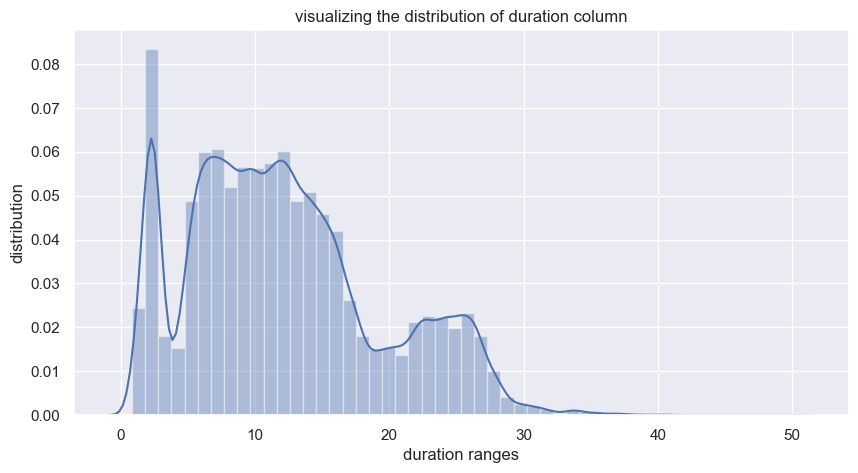

In [73]:
plt.figure(figsize=(10,5))
sns.distplot(df['duration'] )
plt.title('visualizing the distribution of duration column')
plt.xlabel('duration ranges')
plt.ylabel('distribution')
plt.show()

so duration column has a right skewed distribution and shows that most flights falls in the range before almost 17 hours

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\1702678455.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




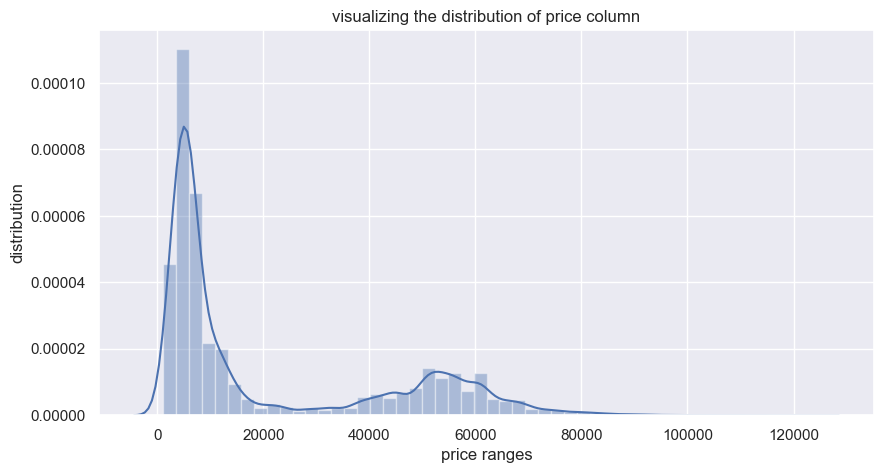

In [74]:
plt.figure(figsize=(10,5))
sns.distplot(df['price'] )
plt.title('visualizing the distribution of price column')
plt.xlabel('price ranges')
plt.ylabel('distribution')
plt.show()

distribution is right skewed as well and tells us that most of the people tends to pay less for there flights

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\2610067342.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




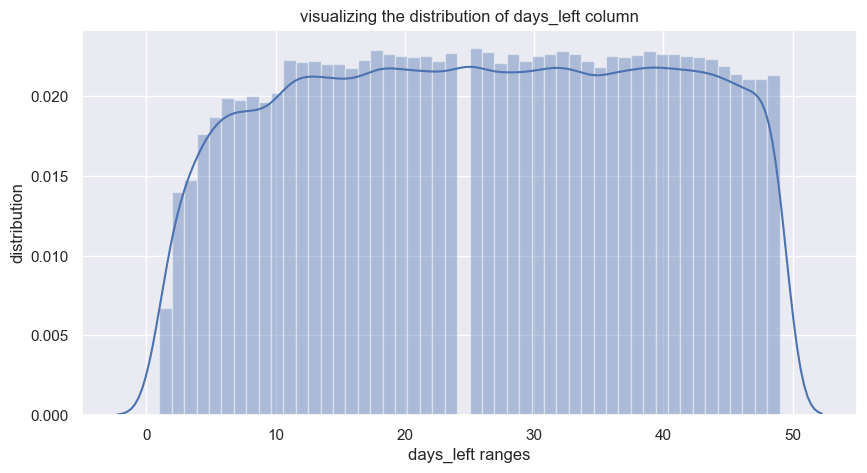

In [75]:
plt.figure(figsize=(10,5))
sns.distplot(df['days_left'] )
plt.title('visualizing the distribution of days_left column')
plt.xlabel('days_left ranges')
plt.ylabel('distribution')
plt.show()

days left column has a uniform distribution 

# checking for outliers

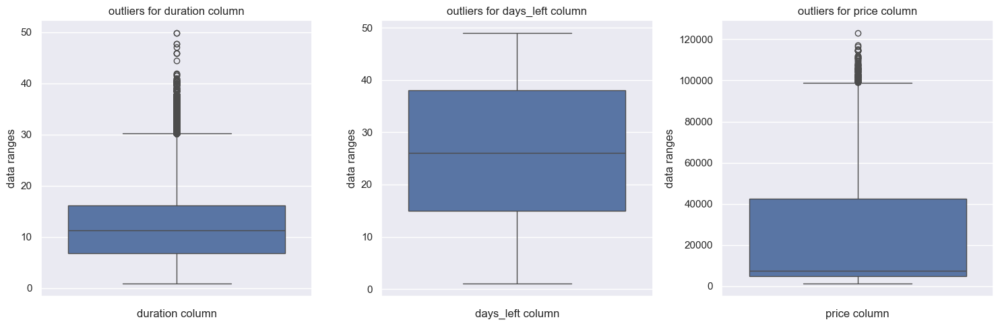

In [76]:
fig =1 
plt.figure(figsize=(15,5))
for col in df.select_dtypes(exclude='object'):
    plt.subplot(1, 3, fig)
    sns.boxplot(data = df , y = col)
    plt.title(f'outliers for {col} column')
    plt.xlabel(f'{col} column')
    plt.ylabel('data ranges')
    fig +=1
plt.tight_layout()
plt.show()


# data visualiztion

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\2609614819.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




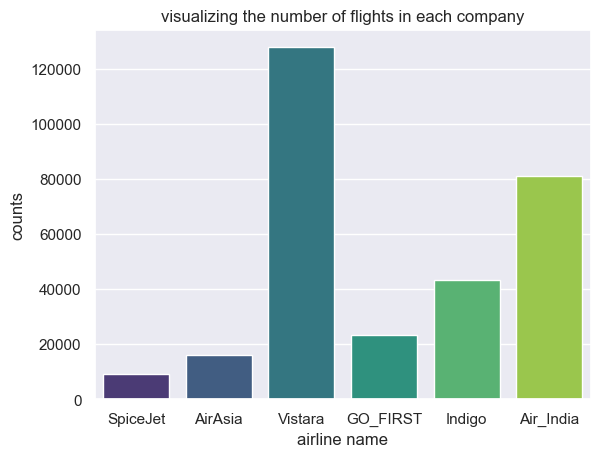

In [77]:
sns.countplot(data = df , x = 'airline' , palette='viridis')
plt.title('visualizing the number of flights in each company')
plt.xlabel('airline name')
plt.ylabel('counts')
plt.show()

most favored flight company is vistara followed by air_india

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\3104906541.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




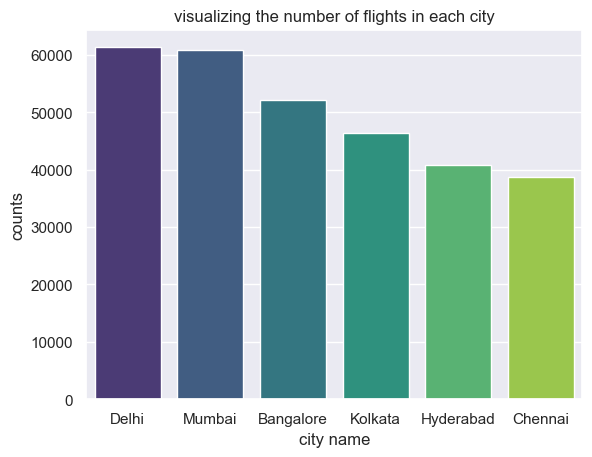

In [78]:
sns.countplot(data = df , x = 'source_city' , palette='viridis')
plt.title('visualizing the number of flights in each city')
plt.xlabel('city name')
plt.ylabel('counts')
plt.show()

so delhi and mumbai has the highest flights rate unlike chennai which has the least

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\4066400600.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




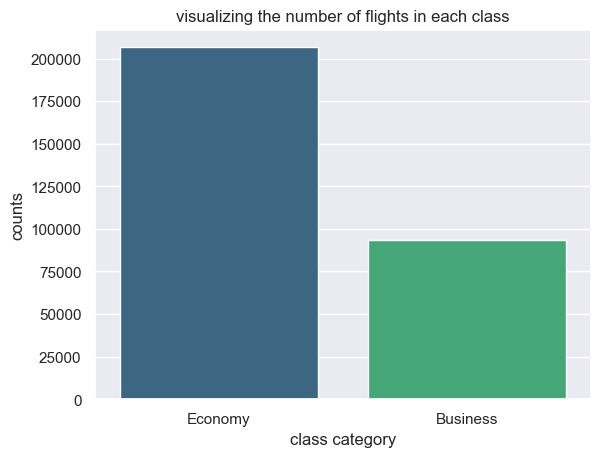

In [79]:
sns.countplot(data = df , x = 'class' , palette='viridis')
plt.title('visualizing the number of flights in each class')
plt.xlabel('class category')
plt.ylabel('counts')
plt.show()

most people book the economy level and luch less book business level

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\2249258067.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




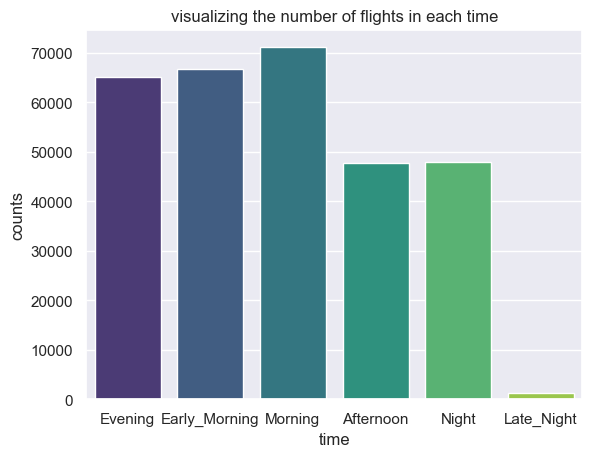

In [80]:
sns.countplot(data = df , x = 'departure_time' , palette='viridis')
plt.title('visualizing the number of flights in each time')
plt.xlabel('time')
plt.ylabel('counts')
plt.show()

most flights is in the morning and almost no flights in late night

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\4129236170.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




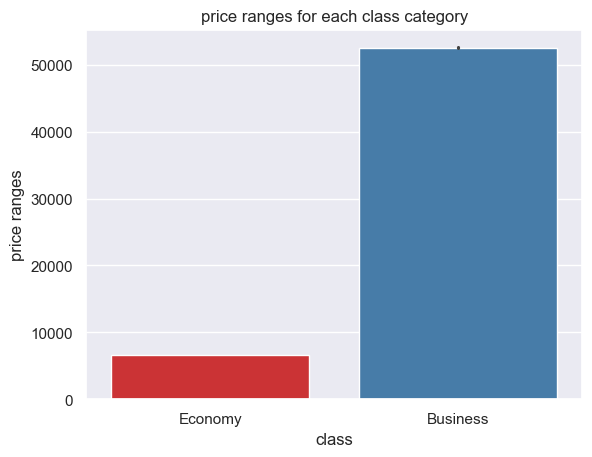

In [81]:
sns.barplot(data = df , y = 'price' , x='class' , palette='Set1')
plt.title('price ranges for each class category')
plt.xlabel('class')
plt.ylabel('price ranges')
plt.show()

price ranges for economy class is much much cheaper than business class and this is why flights in economy class is more than business class

In [82]:
fig = px.scatter(data_frame = df , x = 'price' , y='duration' , color='stops' )
fig.update_layout(
    title = 'relation between the price and duration of the flight',
    title_x = 0.5
)
fig.show()

so duration doesn’t affect the price that much but affects the number of stops

In [83]:
fig = px.scatter(data_frame = df , x = 'price' , y='duration' , color='days_left' )
fig.update_layout(
    title = 'relation between the price and duration of the flight',
    title_x = 0.5
)
fig.show()

number of the days left until the flight doesn’t affect the relation between price and duration

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\4052704735.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




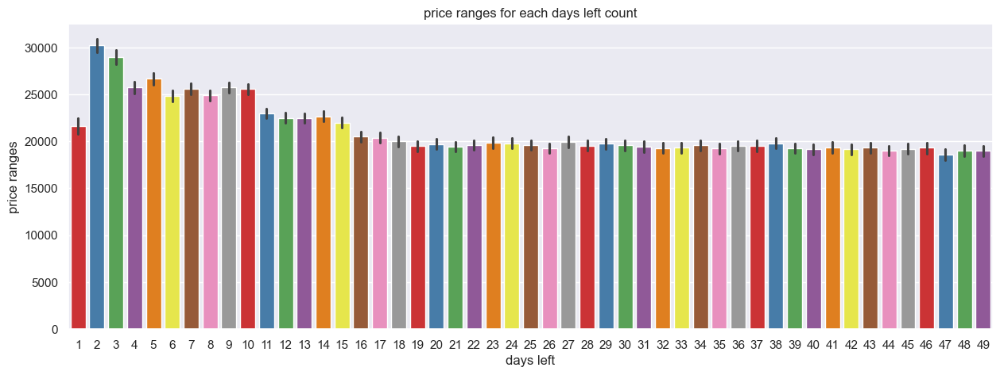

In [84]:
plt.figure(figsize = (15,5))
sns.barplot(data = df , y = 'price' , x='days_left' , palette='Set1')
plt.title('price ranges for each days left count')
plt.xlabel('days left')
plt.ylabel('price ranges')
plt.show()

so the more you pay the less days you wait but it’s effect is not high (starting from 2 days)

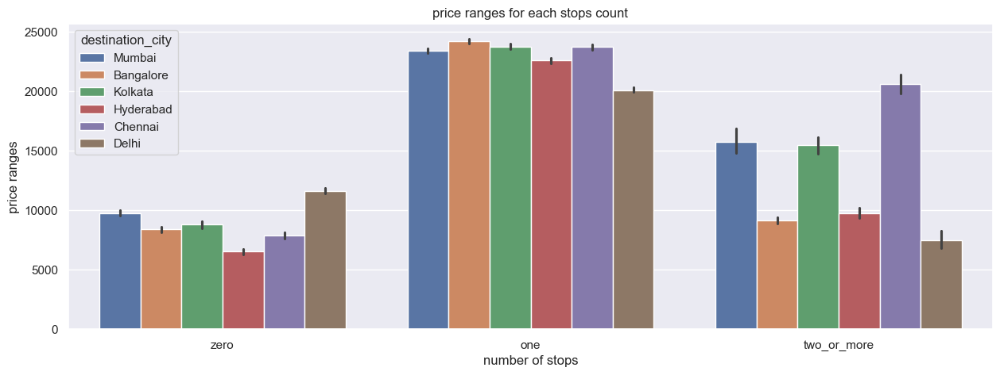

In [85]:
plt.figure(figsize = (15,5))
sns.barplot(data = df , y = 'price' , x='stops' , hue='destination_city')
plt.title('price ranges for each stops count')
plt.xlabel('number of stops')
plt.ylabel('price ranges')
plt.show()

destination city doesn’t affect the number of stops

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\3510443216.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




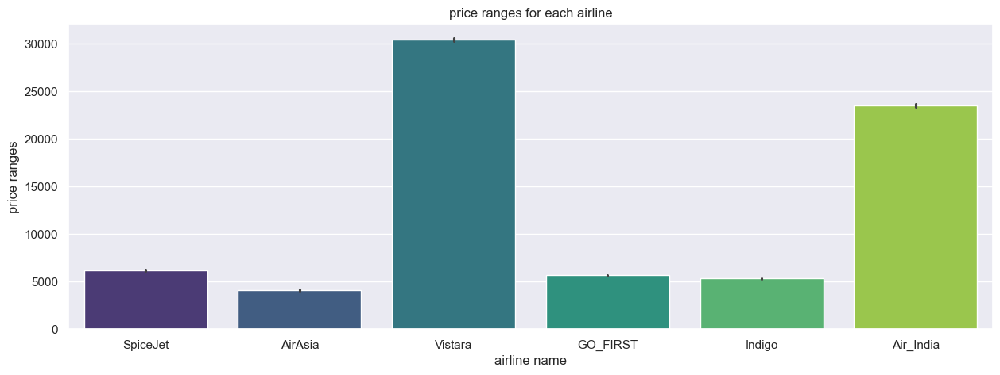

In [86]:
plt.figure(figsize = (15,5))
sns.barplot(data = df , y = 'price' , x='airline' ,palette='viridis')
plt.title('price ranges for each airline')
plt.xlabel('airline name')
plt.ylabel('price ranges')
plt.show()

highest price company is vistara (and the most favored airline too)

In [87]:
grouped = df.groupby(by=['source_city' , 'destination_city'])['price'].mean().sort_values(ascending=False).reset_index()
grouped

,source_city,destination_city,price
0,Chennai,Bangalore,25081.850454
1,Kolkata,Chennai,23660.361040
2,Bangalore,Kolkata,23500.061229
3,Bangalore,Chennai,23321.850078
4,Mumbai,Bangalore,23147.873807
5,Bangalore,Mumbai,23128.618672
6,Mumbai,Chennai,22781.899112
7,Chennai,Mumbai,22765.849647
8,Kolkata,Bangalore,22744.808428
9,Chennai,Kolkata,22669.932407


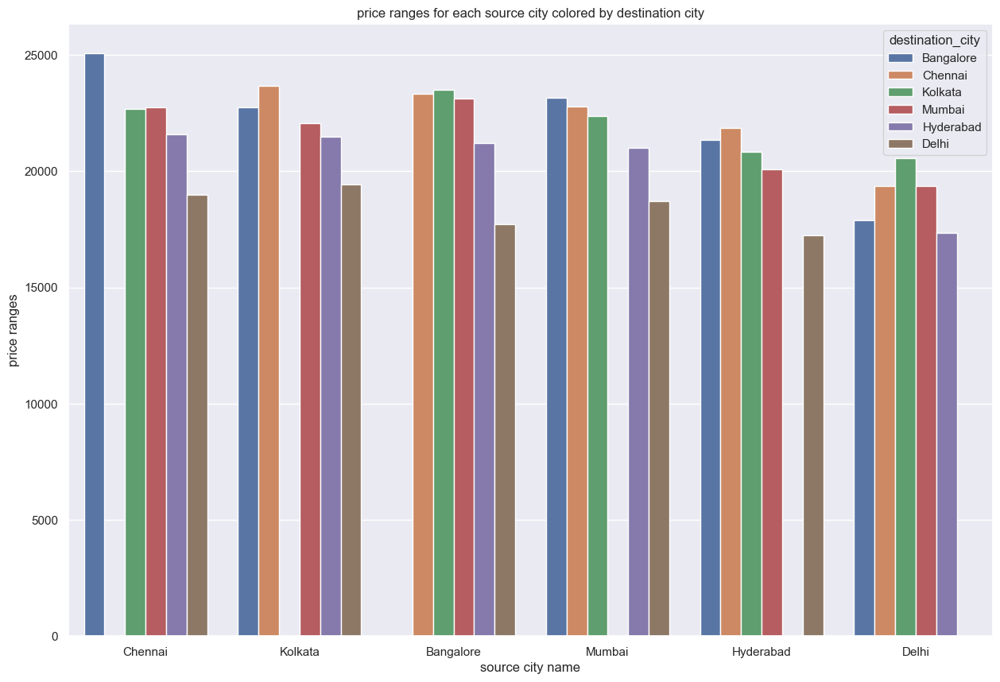

In [88]:
plt.figure(figsize = (15,10))
sns.barplot(data = grouped , y = 'price' , x='source_city' ,hue ='destination_city')
plt.title('price ranges for each source city colored by destination city')
plt.xlabel('source city name')
plt.ylabel('price ranges')
plt.show()

we can see that mean prices in each airline is not the same in all cities and every city has flights for only 5 cities

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\1034247251.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




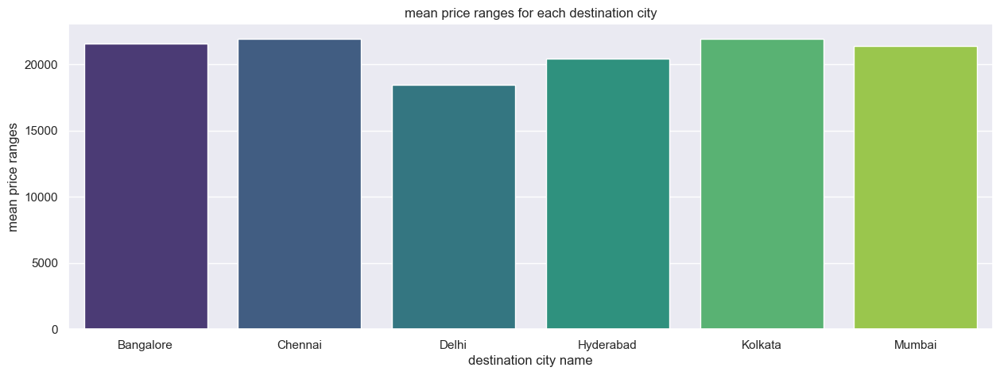

In [89]:
grouped = df.groupby('destination_city')['price'].mean().reset_index()
plt.figure(figsize = (15,5))
sns.barplot(data = grouped , y = 'price' , x='destination_city' , palette='viridis' )
plt.title('mean price ranges for each destination city')
plt.xlabel('destination city name')
plt.ylabel('mean price ranges')
plt.show()

delhi has the least flight mean price

In [90]:
px.scatter(data_frame= df , y = 'duration' , x = 'price' , color='arrival_time')

arrival time doesn’t affect the relation between price and duration

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\3006850390.py:1: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




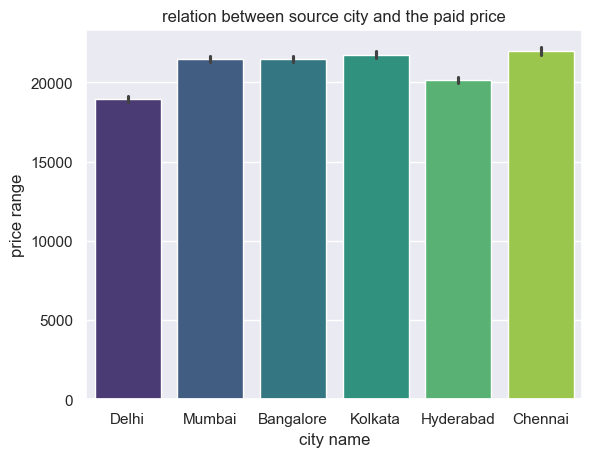

In [91]:
sns.barplot(data = df , x = 'source_city' , y = 'price' , palette='viridis')
plt.title('relation between source city and the paid price')
plt.xlabel('city name')
plt.ylabel('price range')
plt.show()

there is some diffrence in price ranges based on source city

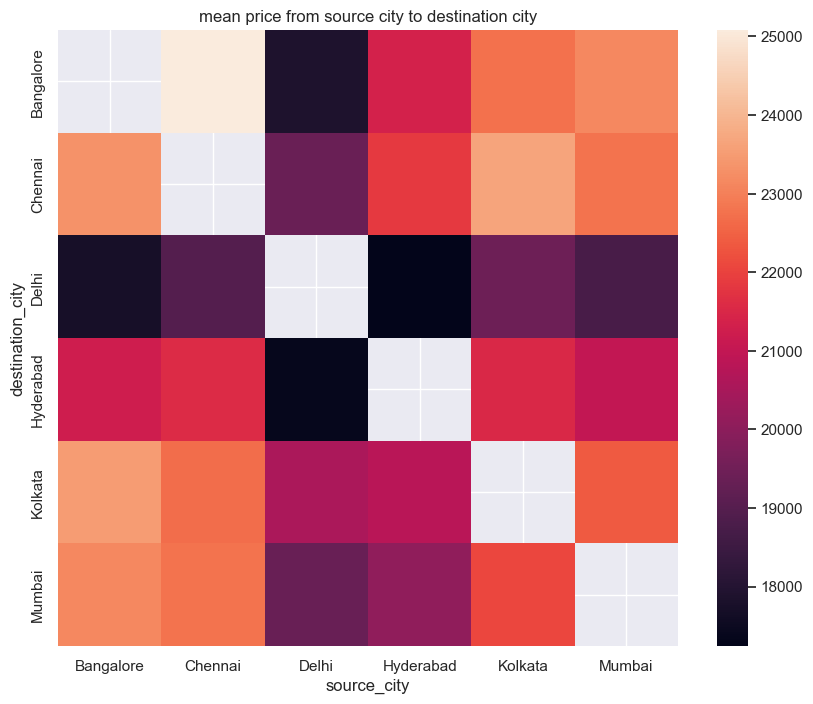

In [92]:
pivot = pd.pivot_table(data = df , values = 'price' , index = 'destination_city' , columns='source_city' , aggfunc='mean')
plt.figure(figsize=(10,8))
sns.heatmap(pivot)
plt.title('mean price from source city to destination city')
plt.show()

not all cities have flights to all other cities as mentioned before

# feature engineering

so while exploring the relation between cities and the price there was not a high effect so i will try to get the distance from source city and destination city

In [93]:
from geopy.distance import geodesic


df['source_city'] = df['source_city'].str.title()
df['destination_city'] = df['destination_city'].str.title()


city_coords = {
    'Delhi': (28.7041, 77.1025),
    'Mumbai': (19.0760, 72.8777),
    'Bangalore': (12.9716, 77.5946),
    'Kolkata': (22.5726, 88.3639),
    'Hyderabad': (17.3850, 78.4867),
    'Chennai': (13.0827, 80.2707)
}


df['distance'] = df.apply(
    lambda row: geodesic(city_coords[row['source_city']], city_coords[row['destination_city']]).km,
    axis=1
)


df['distance'] = df['distance'].round()

df


,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price,distance
0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953,1150.0
1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953,1150.0
2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956,1150.0
3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955,1150.0
4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955,1150.0
...,...,...,...,...,...,...,...,...,...,...,...,...
300148,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,69265,513.0
300149,Vistara,UK-826,Chennai,Afternoon,one,Night,Hyderabad,Business,10.42,49,77105,513.0
300150,Vistara,UK-832,Chennai,Early_Morning,one,Night,Hyderabad,Business,13.83,49,79099,513.0
300151,Vistara,UK-828,Chennai,Early_Morning,one,Evening,Hyderabad,Business,10.00,49,81585,513.0


In [94]:
df.distance.nunique()

15

In [95]:
fig = px.scatter(data_frame= df ,y = 'price' , x = 'distance' , color = 'class'  , hover_name='days_left')
fig.update_layout(title = 'Price vs Distance' ,title_x = 0.5)
fig.show()

most of the people who pay more waits days less even if the distance is the same

C:\Users\DELL\AppData\Local\Temp\ipykernel_12100\4273147537.py:1: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




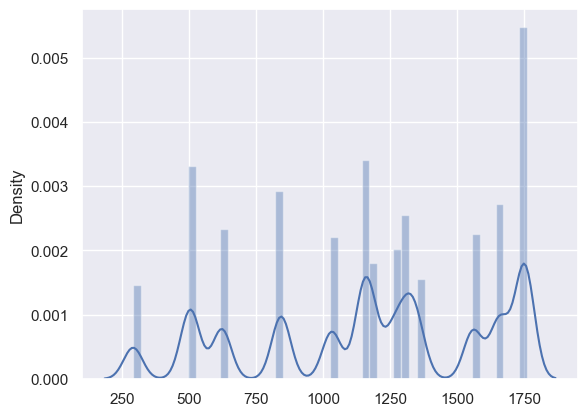

In [97]:
sns.distplot( x = df['distance'])
plt.show()

it has no obvise distribution from caues it is discrete values

# feature selection

during the visualization there was no obvise effect from the droped columns on the price


In [98]:
df.drop(columns=['flight','source_city','departure_time','arrival_time' , 'destination_city'] , inplace= True)
df

,airline,stops,class,duration,days_left,price,distance
0,SpiceJet,zero,Economy,2.17,1,5953,1150.0
1,SpiceJet,zero,Economy,2.33,1,5953,1150.0
2,AirAsia,zero,Economy,2.17,1,5956,1150.0
3,Vistara,zero,Economy,2.25,1,5955,1150.0
4,Vistara,zero,Economy,2.33,1,5955,1150.0
...,...,...,...,...,...,...,...
300148,Vistara,one,Business,10.08,49,69265,513.0
300149,Vistara,one,Business,10.42,49,77105,513.0
300150,Vistara,one,Business,13.83,49,79099,513.0
300151,Vistara,one,Business,10.00,49,81585,513.0


# label encoding

- since there is no major favor between airline companies then i will use one hot encoding for it
- number of stops does not effect the price that much then i’ll encode it to yes or no then use one hot encoding
- for class column i’ll use label encoding since business has higher price than economy


In [106]:
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder(sparse_output=False ,drop='first' )

In [108]:
encoded = ohe.fit_transform(df[['airline']])
encoded_df = pd.DataFrame(encoded , columns= ohe.get_feature_names_out(['airline']))
encoded_df

,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara
0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.0,1.0,0.0
2,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,1.0
4,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...
300148,0.0,0.0,0.0,0.0,1.0
300149,0.0,0.0,0.0,0.0,1.0
300150,0.0,0.0,0.0,0.0,1.0
300151,0.0,0.0,0.0,0.0,1.0


In [ ]:
# mergeing data frames together
df = pd.concat([df , encoded_df] , axis = 1 )
df

,airline,stops,class,duration,days_left,price,distance,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara
0,SpiceJet,zero,Economy,2.17,1,5953,1150.0,0.0,0.0,0.0,1.0,0.0
1,SpiceJet,zero,Economy,2.33,1,5953,1150.0,0.0,0.0,0.0,1.0,0.0
2,AirAsia,zero,Economy,2.17,1,5956,1150.0,0.0,0.0,0.0,0.0,0.0
3,Vistara,zero,Economy,2.25,1,5955,1150.0,0.0,0.0,0.0,0.0,1.0
4,Vistara,zero,Economy,2.33,1,5955,1150.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
300148,Vistara,one,Business,10.08,49,69265,513.0,0.0,0.0,0.0,0.0,1.0
300149,Vistara,one,Business,10.42,49,77105,513.0,0.0,0.0,0.0,0.0,1.0
300150,Vistara,one,Business,13.83,49,79099,513.0,0.0,0.0,0.0,0.0,1.0
300151,Vistara,one,Business,10.00,49,81585,513.0,0.0,0.0,0.0,0.0,1.0


In [113]:
# working with stops column
print(df.stops.unique())
df.stops.replace({'zero' : 'no' ,'one': 'yes' ,'two_or_more' : 'yes'  } , inplace=True)
df.stops.unique()

['zero' 'one' 'two_or_more']


array(['no', 'yes'], dtype=object)

In [115]:
df['stops'] = ohe.fit_transform(df[['stops']])
df

,airline,stops,class,duration,days_left,price,distance,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara
0,SpiceJet,0.0,Economy,2.17,1,5953,1150.0,0.0,0.0,0.0,1.0,0.0
1,SpiceJet,0.0,Economy,2.33,1,5953,1150.0,0.0,0.0,0.0,1.0,0.0
2,AirAsia,0.0,Economy,2.17,1,5956,1150.0,0.0,0.0,0.0,0.0,0.0
3,Vistara,0.0,Economy,2.25,1,5955,1150.0,0.0,0.0,0.0,0.0,1.0
4,Vistara,0.0,Economy,2.33,1,5955,1150.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
300148,Vistara,1.0,Business,10.08,49,69265,513.0,0.0,0.0,0.0,0.0,1.0
300149,Vistara,1.0,Business,10.42,49,77105,513.0,0.0,0.0,0.0,0.0,1.0
300150,Vistara,1.0,Business,13.83,49,79099,513.0,0.0,0.0,0.0,0.0,1.0
300151,Vistara,1.0,Business,10.00,49,81585,513.0,0.0,0.0,0.0,0.0,1.0


In [117]:
# working with class column
from sklearn.preprocessing import OrdinalEncoder

# to control the order of the encoding
rank = [['Economy' , 'Business']]
ord_encoder = OrdinalEncoder(categories=rank)

df['class'] = ord_encoder.fit_transform(df[['class']])
df

,airline,stops,class,duration,days_left,price,distance,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara
0,SpiceJet,0.0,0.0,2.17,1,5953,1150.0,0.0,0.0,0.0,1.0,0.0
1,SpiceJet,0.0,0.0,2.33,1,5953,1150.0,0.0,0.0,0.0,1.0,0.0
2,AirAsia,0.0,0.0,2.17,1,5956,1150.0,0.0,0.0,0.0,0.0,0.0
3,Vistara,0.0,0.0,2.25,1,5955,1150.0,0.0,0.0,0.0,0.0,1.0
4,Vistara,0.0,0.0,2.33,1,5955,1150.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
300148,Vistara,1.0,1.0,10.08,49,69265,513.0,0.0,0.0,0.0,0.0,1.0
300149,Vistara,1.0,1.0,10.42,49,77105,513.0,0.0,0.0,0.0,0.0,1.0
300150,Vistara,1.0,1.0,13.83,49,79099,513.0,0.0,0.0,0.0,0.0,1.0
300151,Vistara,1.0,1.0,10.00,49,81585,513.0,0.0,0.0,0.0,0.0,1.0


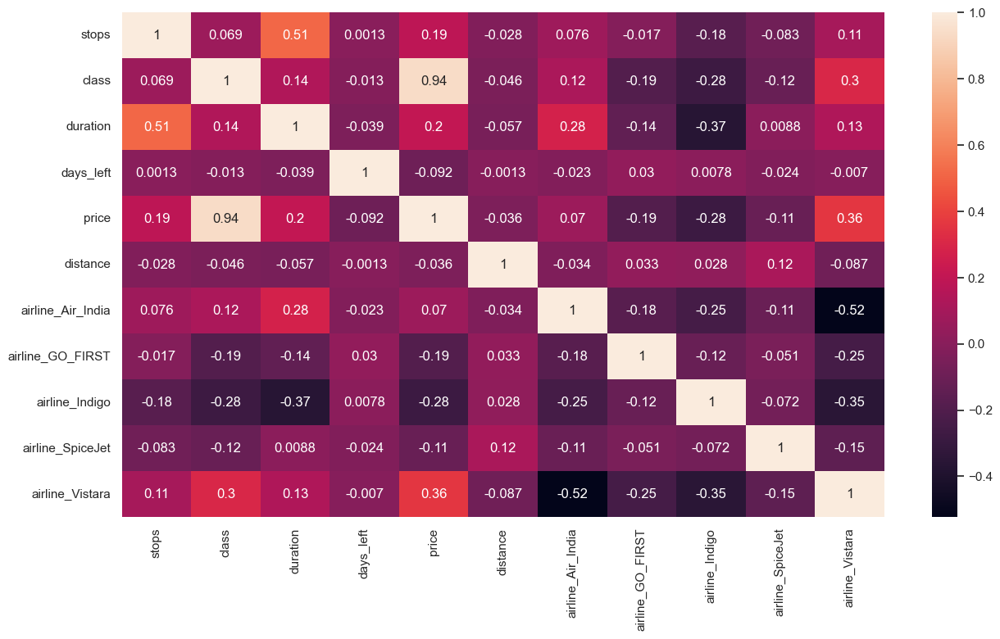

In [125]:
plt.figure(figsize=(15,8))
sns.heatmap(df.drop(columns='airline').corr() ,annot=True)
plt.show()

# splitting data

In [118]:
x = df.drop(columns=['price','airline'])
y = df['price']

In [119]:
x

,stops,class,duration,days_left,distance,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara
0,0.0,0.0,2.17,1,1150.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,2.33,1,1150.0,0.0,0.0,0.0,1.0,0.0
2,0.0,0.0,2.17,1,1150.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,2.25,1,1150.0,0.0,0.0,0.0,0.0,1.0
4,0.0,0.0,2.33,1,1150.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...
300148,1.0,1.0,10.08,49,513.0,0.0,0.0,0.0,0.0,1.0
300149,1.0,1.0,10.42,49,513.0,0.0,0.0,0.0,0.0,1.0
300150,1.0,1.0,13.83,49,513.0,0.0,0.0,0.0,0.0,1.0
300151,1.0,1.0,10.00,49,513.0,0.0,0.0,0.0,0.0,1.0


In [120]:
y

0          5953
1          5953
2          5956
3          5955
4          5955
          ...  
300148    69265
300149    77105
300150    79099
300151    81585
300152    81585
Name: price, Length: 300153, dtype: int64

In [126]:
from sklearn.model_selection import train_test_split
x_train , x_test , y_train , y_test = train_test_split(x , y , random_state=42 , test_size=0.2 , shuffle=True)

# feature scaling

### for scaling the numerical features i’ll use the following :
- log tranform for price and duration columns as they have right skewed distribution
- i will use min max scaler for days left and distance columns as they fall in range

In [131]:
# first scaling x_train and x_test data
from sklearn.preprocessing import MinMaxScaler
MMS = MinMaxScaler()

# log transform for duration column
x_train['duration'] = np.log(x_train['duration'])
x_test['duration'] = np.log(x_test['duration'])

# min max scaler for days left and distance columns
x_train['distance'] = MMS.fit_transform(x_train[['distance']])
x_test['distance'] = MMS.transform(x_test[['distance']])

x_train['days_left'] = MMS.fit_transform(x_train[['days_left']])
x_test['days_left'] = MMS.transform(x_test[['days_left']])



In [132]:
x_train

,stops,class,duration,days_left,distance,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara
148417,1.0,0.0,2.966303,0.104167,0.724302,1.0,0.0,0.0,0.0,0.0
36879,1.0,0.0,1.945910,0.250000,1.000000,0.0,0.0,1.0,0.0,0.0
274531,1.0,1.0,3.052585,0.895833,0.724302,1.0,0.0,0.0,0.0,0.0
166397,1.0,0.0,2.327278,0.208333,0.140912,0.0,0.0,0.0,0.0,1.0
272722,1.0,1.0,3.277145,0.083333,0.724302,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...
119879,1.0,0.0,3.020425,0.020833,0.699115,0.0,0.0,0.0,0.0,1.0
259178,1.0,1.0,3.235536,0.125000,0.000000,0.0,0.0,0.0,0.0,1.0
131932,1.0,0.0,2.615204,0.583333,0.929884,1.0,0.0,0.0,0.0,0.0
146867,1.0,0.0,2.119863,0.791667,0.606535,0.0,1.0,0.0,0.0,0.0


In [134]:
# scaling y_train and y_test data
y_train = np.log(y_train)
y_test = np.log(y_test)

In [135]:
y_train

148417     9.512221
36879      9.204322
274531    10.932803
166397     8.978030
272722    10.924174
            ...    
119879    10.037538
259178    10.698288
131932     8.537388
146867     8.625868
121958     8.754476
Name: price, Length: 240122, dtype: float64

# prediction using linear regression

In [138]:
x_train = x_train.values
x_test = x_test.values
y_train = y_train.values
y_test = y_test.values

In [139]:
from sklearn.linear_model import LinearRegression
LR = LinearRegression()

In [140]:
LR.fit(x_train , y_train)

LinearRegression()

# evaluating for underfitting

In [142]:
from sklearn.metrics import mean_absolute_error , mean_squared_error , r2_score

In [143]:
y_train_pred = LR.predict(x_train)

In [144]:
print(f'the value of MAE is -> {mean_absolute_error(y_train , y_train_pred)}')
print(f'the value of MSE is -> {mean_squared_error(y_train , y_train_pred)}')
print(f'the value of R2 score is -> {r2_score(y_train , y_train_pred)}')

the value of MAE is -> 0.26425500962150256
the value of MSE is -> 0.11246442714919459
the value of R2 score is -> 0.9091683810497894


the error rate is low and r2 score is great , model doesn’t suffer from underfitting

# evaluating for overfitting

In [145]:
y_test_pred = LR.predict(x_test)

In [146]:
print(f'the value of MAE is -> {mean_absolute_error(y_test , y_test_pred)}')
print(f'the value of MSE is -> {mean_squared_error(y_test , y_test_pred)}')
print(f'the value of R2 score is -> {r2_score(y_test , y_test_pred)}')

the value of MAE is -> 0.2635315339124962
the value of MSE is -> 0.11162322666409166
the value of R2 score is -> 0.9098932351877543


error rate and r2 score is so close to the training , model doesn’t suffer from overfitting

In [147]:
import joblib
joblib.dump(LR , 'LR_model.pkl')

['LR_model.pkl']

# thanks